<a href="https://colab.research.google.com/github/AmirAzz/Test/blob/main/yolo8_segment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi


Wed Mar 29 13:13:04 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8     9W /  70W |      3MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
# Pip install method (recommended)

!pip install ultralytics==8.0.28

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 25.6/78.2 GB disk)


In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

In [ ]:
!pip install -q roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="vi4sAIgCTFi0H4tZwvA4")
project = rf.workspace("kios-alpsc").project("rescuenet-yolo8")
dataset = project.version(3).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.28, to fix: `pip install ultralytics<=8.0.20`

Extracting Dataset Version Zip to RescueNet-YOLO8-3 in yolov8:: 100%|██████████| 2618/2618 [00:12<00:00, 216.73it/s]


In [ ]:
%cd {HOME}

!yolo task=segment mode=train model=yolov8s-seg.pt data=/content/data.yaml epochs=10 imgsz=640

/content
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=segment, mode=train, model=yolov8s-seg.pt, data=/content/data.yaml, epochs=10, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=None, 

/content


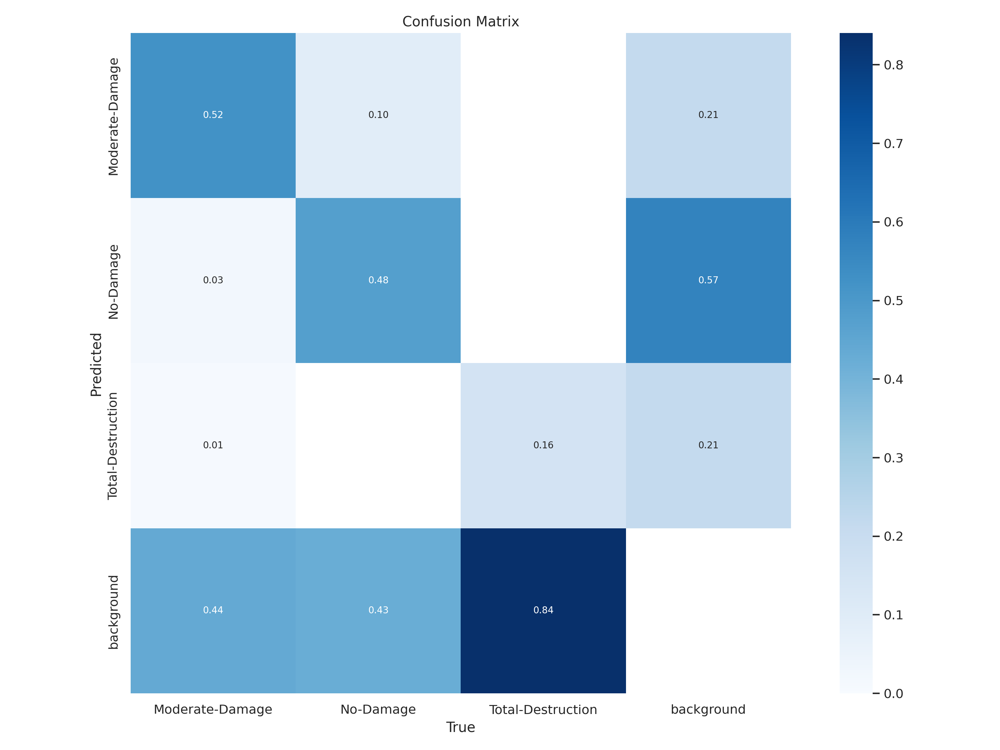

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train7/confusion_matrix.png', width=600)

/content


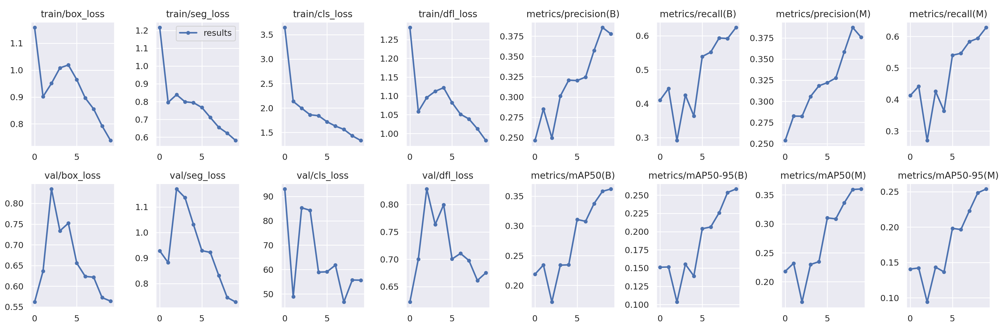

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train7/results.png', width=600)

/content


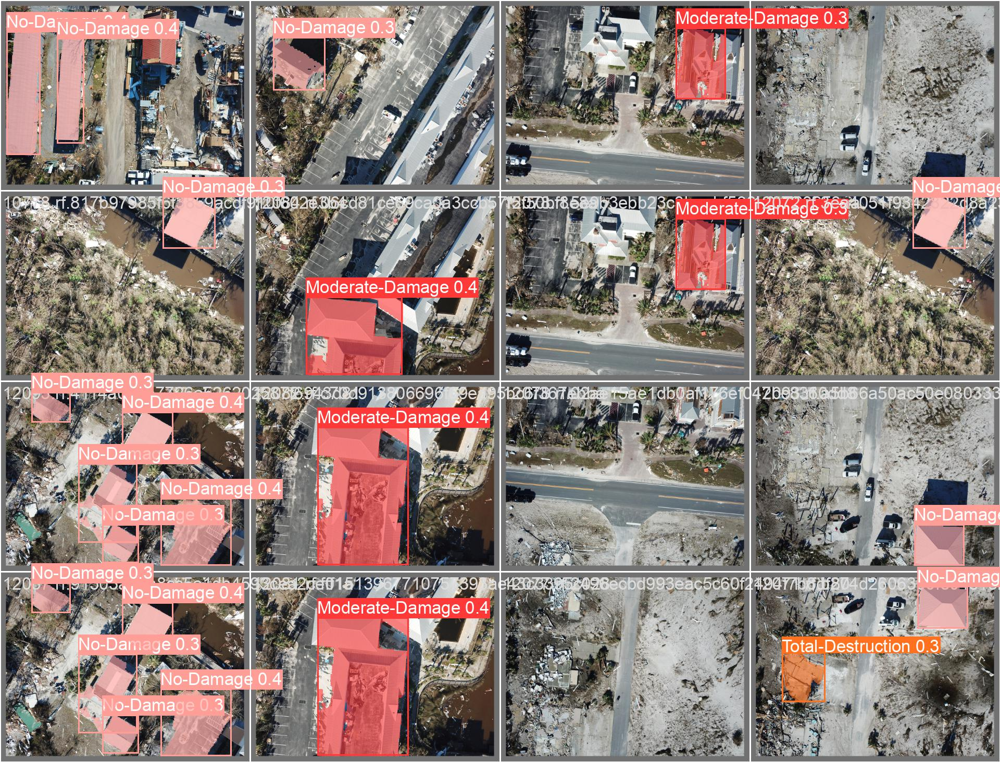

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train7/val_batch0_pred.jpg', width=600)

In [ ]:
%cd {HOME}

!yolo task=segment mode=val model={HOME}/runs/segment/train7/weights/best.pt data=/content/data.yaml save=true

/content
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11780761 parameters, 0 gradients, 42.4 GFLOPs
val: Scanning /content/RescueNet-YOLO8-3/valid.cache... 240 images, 240 backgrounds, 0 corrupt: 100% 480/480 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 30/30 [01:40<00:00,  3.35s/it]
                   all        480        896      0.377      0.624      0.362      0.258      0.375      0.628       0.36      0.253
       Moderate-Damage        480        231      0.315       0.71       0.33      0.252       0.31       0.71      0.326      0.241
             No-Damage        480        389      0.412      0.725      0.424      0.344       0.41       0.73      0.424      0.339
     Total-Destruction        480        276      0.405      0.438      0.332       0.18      0.405      0.445      0.332 

In [ ]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train7/weights/best.pt conf=0.25 source={dataset.location}/test/images save=true

/content
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11780761 parameters, 0 gradients, 42.4 GFLOPs

image 1/168 /content/RescueNet-YOLO8-3/test/images/10794.rf.29e53f49a4003d1444761d6a5c4ec533.jpg: 480x640 20.2ms
image 2/168 /content/RescueNet-YOLO8-3/test/images/10794.rf.ddfbd672875a0682c0ffe8b62a109d7d.jpg: 480x640 18.7ms
image 3/168 /content/RescueNet-YOLO8-3/test/images/10801-Copy.rf.5dd2d867bb650ed3dc5fcb8fc24bcb92.jpg: 480x640 1 No-Damage, 2 Total-Destructions, 18.7ms
image 4/168 /content/RescueNet-YOLO8-3/test/images/11388.rf.fd671bb5553cab652937f1396f88704c.jpg: 480x640 4 No-Damages, 18.7ms
image 5/168 /content/RescueNet-YOLO8-3/test/images/11415.rf.1036839c84cbddc7177e700e891d6e1d.jpg: 480x640 1 Moderate-Damage, 1 No-Damage, 18.7ms
image 6/168 /content/RescueNet-YOLO8-3/test/images/11419.rf.21cecd7fe4c68c02b7244ed5cb96a4f2.jpg: 480x640 1 Moderate-Damage, 2 No-Damages, 18.7ms
image 7/168 /conten

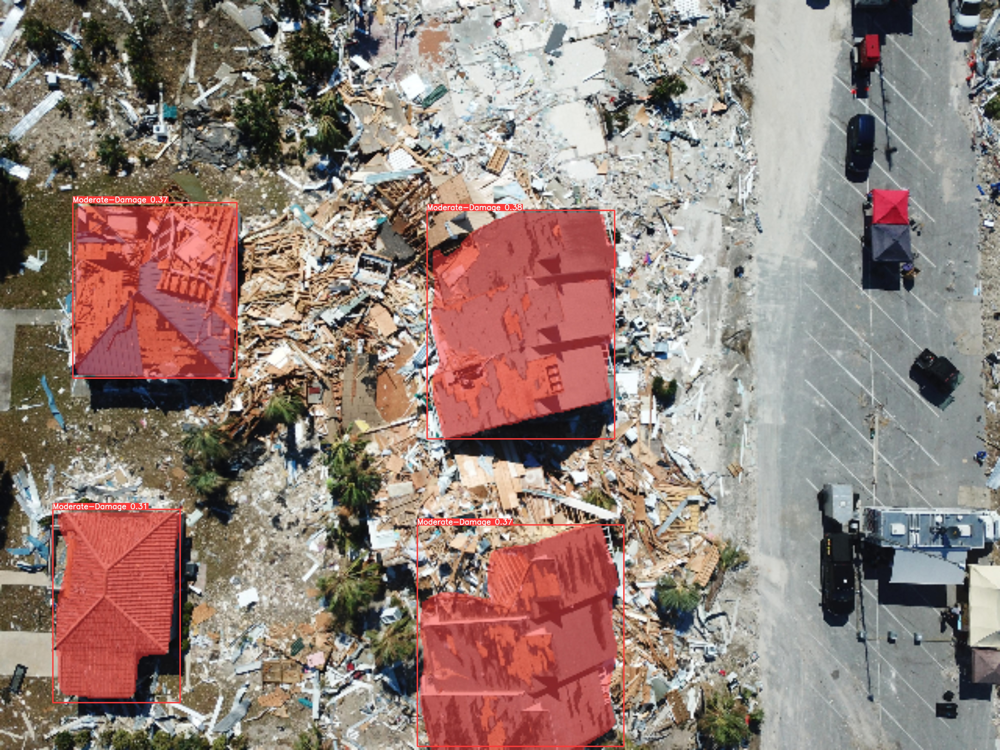

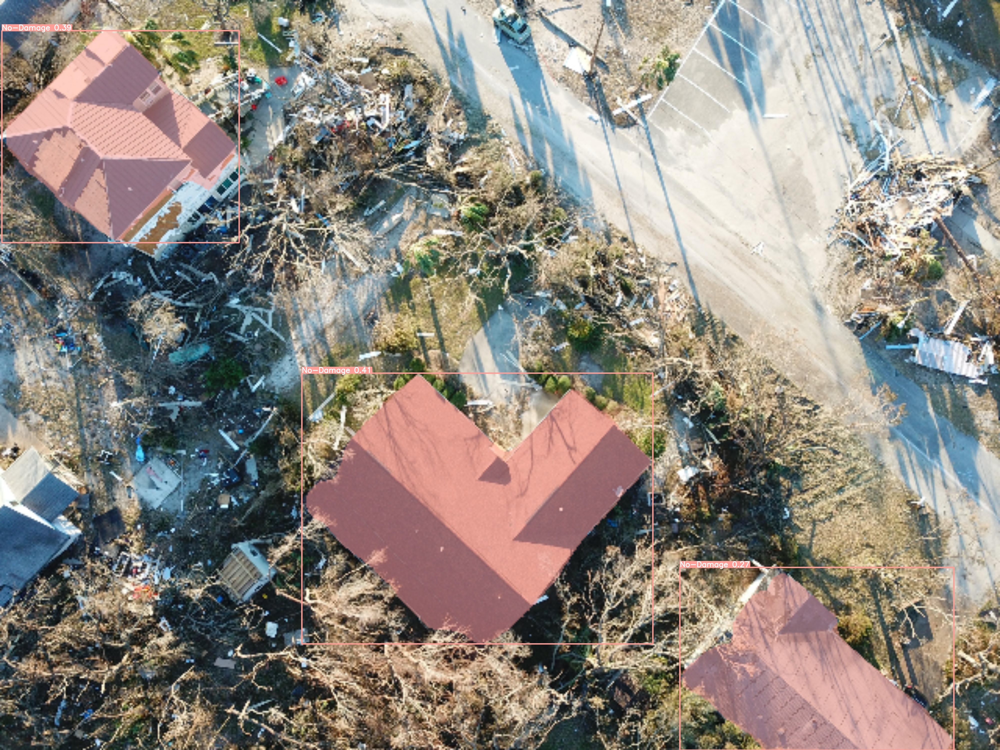

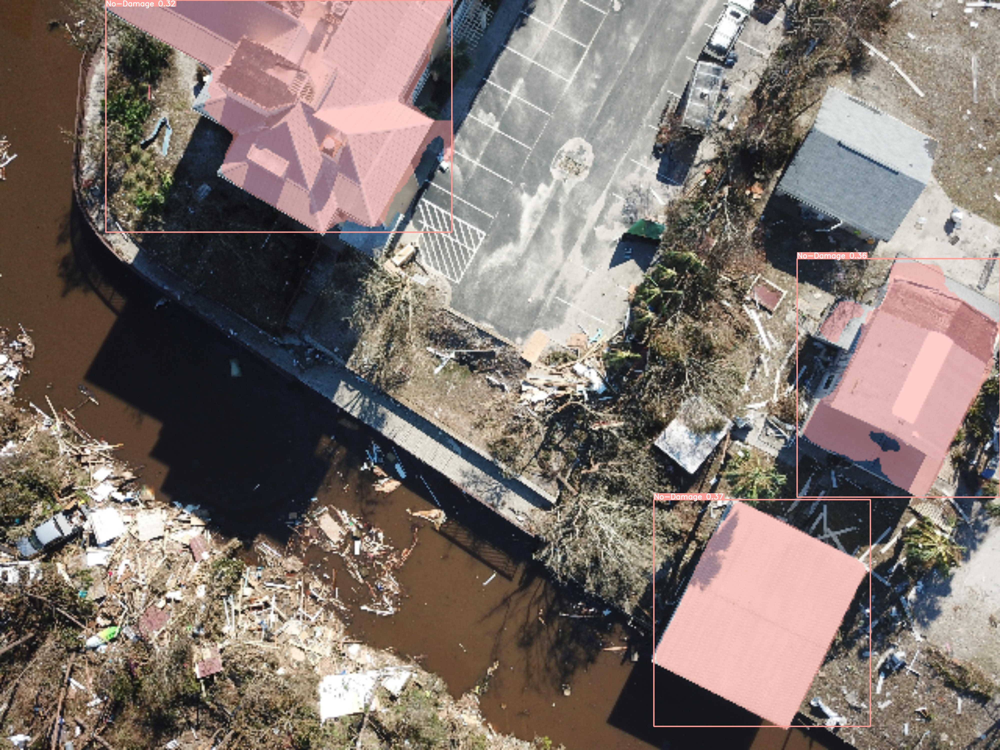

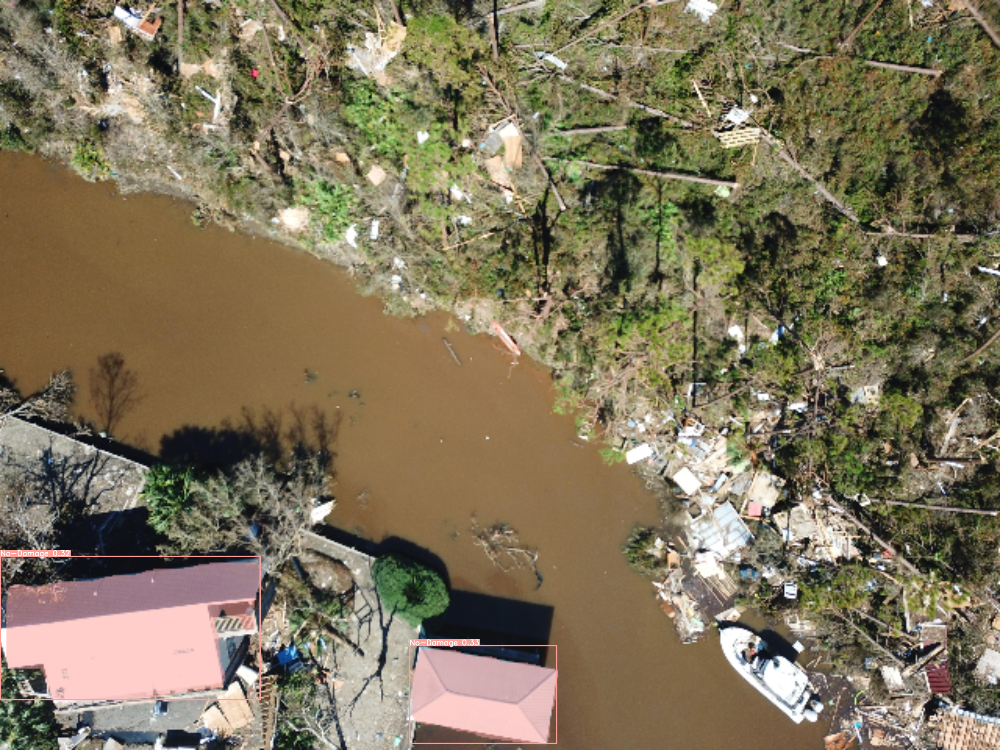

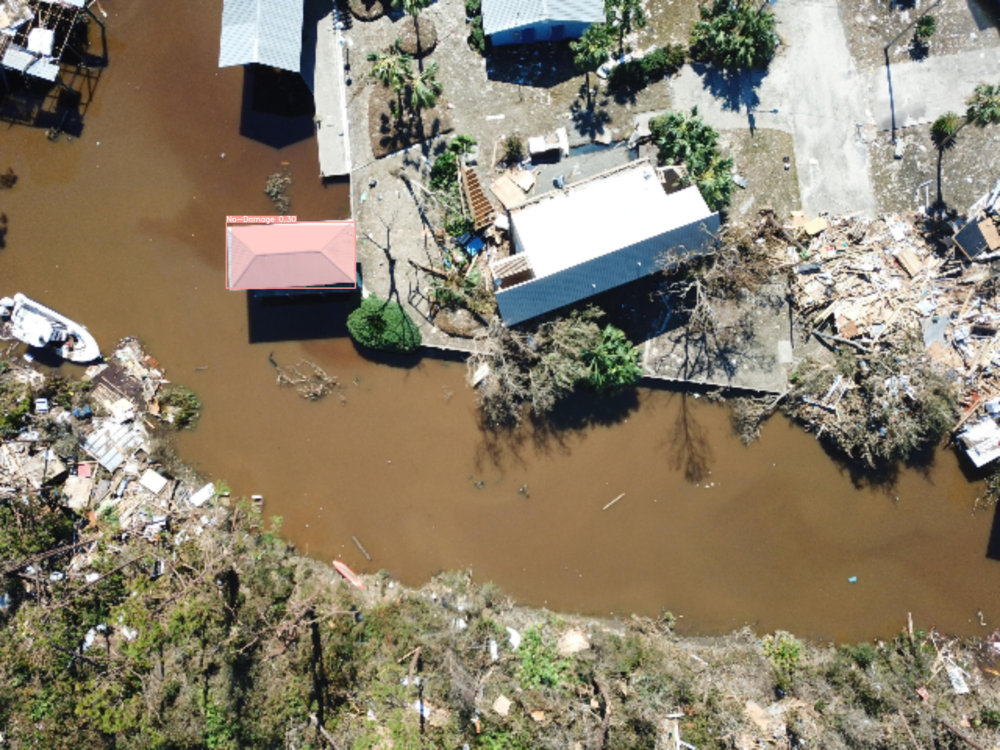

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/segment/predict/*.jpg')[:5]:
      display(Image(filename=image_path, height=600))
      print("\n")

In [ ]:
%cd {HOME}

!yolo task=segment mode=train model=yolov8l-seg.pt data=/content/data.yaml epochs=10 imgsz=640

/content
100% 88.1M/88.1M [00:01<00:00, 56.6MB/s]
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=segment, mode=train, model=yolov8l-seg.pt, data=/content/data.yaml, epochs=10, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dy

/content


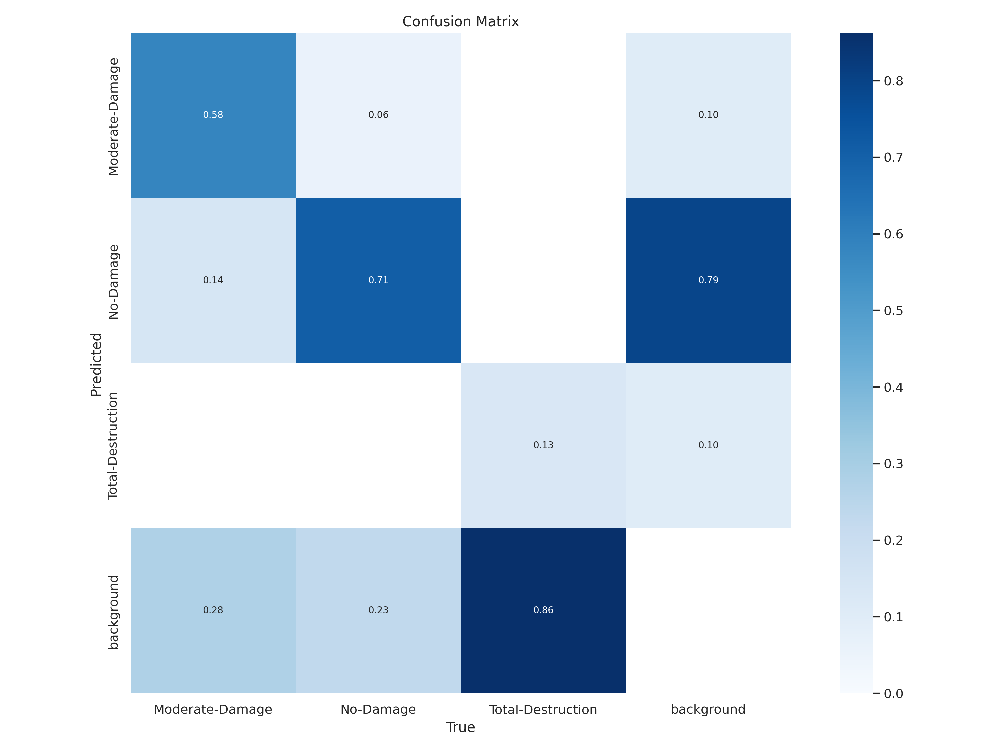

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train8/confusion_matrix.png', width=600)

/content


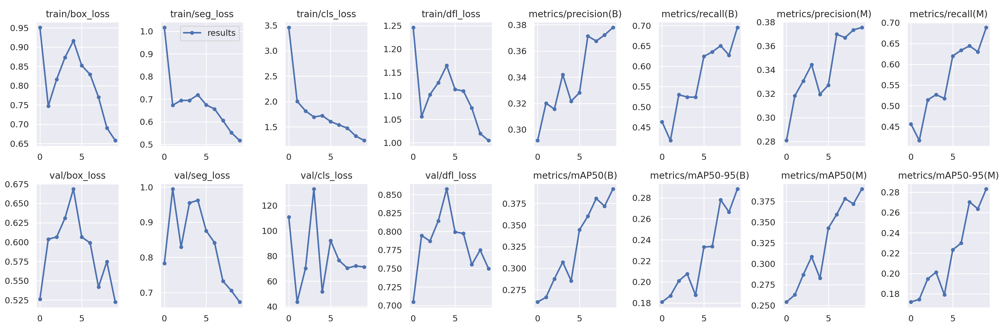

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train8/results.png', width=600)

/content


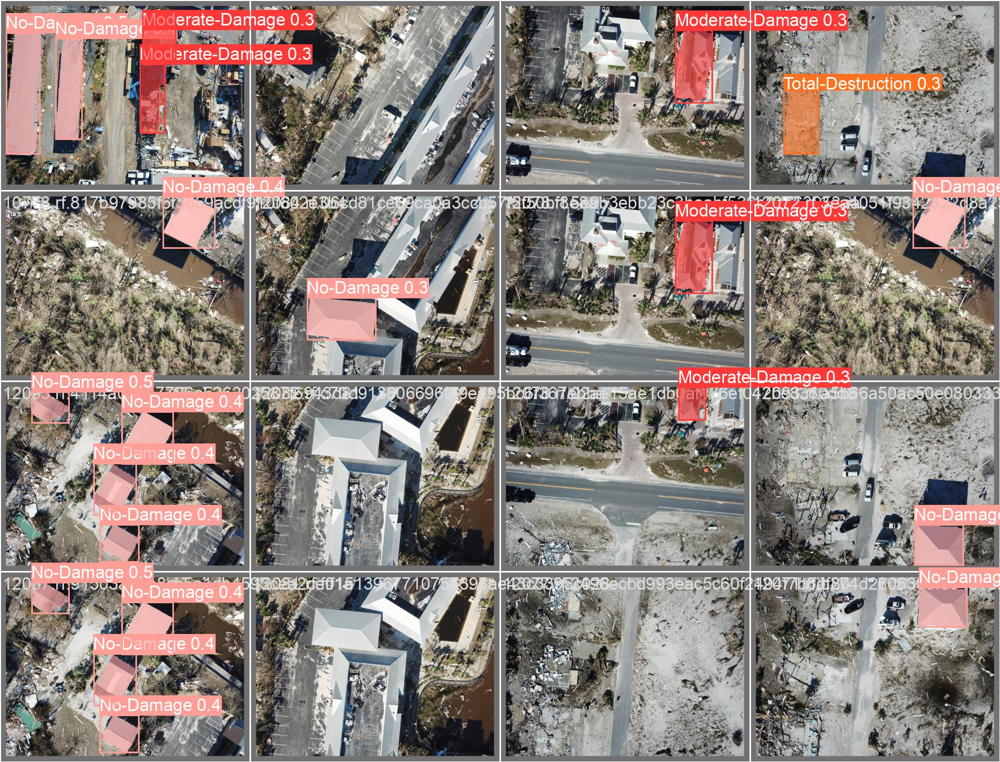

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train8/val_batch0_pred.jpg', width=600)

In [ ]:
%cd {HOME}

!yolo task=segment mode=val model={HOME}/runs/segment/train8/weights/best.pt data=/content/data.yaml save=true

/content
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8l-seg summary (fused): 295 layers, 45914201 parameters, 0 gradients, 220.1 GFLOPs
val: Scanning /content/RescueNet-YOLO8-3/valid.cache... 240 images, 240 backgrounds, 0 corrupt: 100% 480/480 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 30/30 [01:46<00:00,  3.56s/it]
                   all        480        896      0.378      0.696      0.391      0.288      0.376      0.693      0.389      0.282
       Moderate-Damage        480        231      0.355      0.762      0.406       0.32      0.355      0.762      0.408      0.314
             No-Damage        480        389      0.377      0.846      0.432      0.357      0.378      0.848      0.432       0.35
     Total-Destruction        480        276      0.403       0.48      0.334      0.186      0.394      0.469      0.327

In [ ]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train8/weights/best.pt conf=0.25 source={dataset.location}/test/images save=true

/content
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8l-seg summary (fused): 295 layers, 45914201 parameters, 0 gradients, 220.1 GFLOPs

image 1/168 /content/RescueNet-YOLO8-3/test/images/10794.rf.29e53f49a4003d1444761d6a5c4ec533.jpg: 480x640 63.6ms
image 2/168 /content/RescueNet-YOLO8-3/test/images/10794.rf.ddfbd672875a0682c0ffe8b62a109d7d.jpg: 480x640 62.6ms
image 3/168 /content/RescueNet-YOLO8-3/test/images/10801-Copy.rf.5dd2d867bb650ed3dc5fcb8fc24bcb92.jpg: 480x640 1 No-Damage, 1 Total-Destruction, 62.6ms
image 4/168 /content/RescueNet-YOLO8-3/test/images/11388.rf.fd671bb5553cab652937f1396f88704c.jpg: 480x640 5 No-Damages, 62.6ms
image 5/168 /content/RescueNet-YOLO8-3/test/images/11415.rf.1036839c84cbddc7177e700e891d6e1d.jpg: 480x640 1 No-Damage, 62.6ms
image 6/168 /content/RescueNet-YOLO8-3/test/images/11419.rf.21cecd7fe4c68c02b7244ed5cb96a4f2.jpg: 480x640 3 No-Damages, 62.7ms
image 7/168 /content/RescueNet-YOLO8-3/test/images/11426-

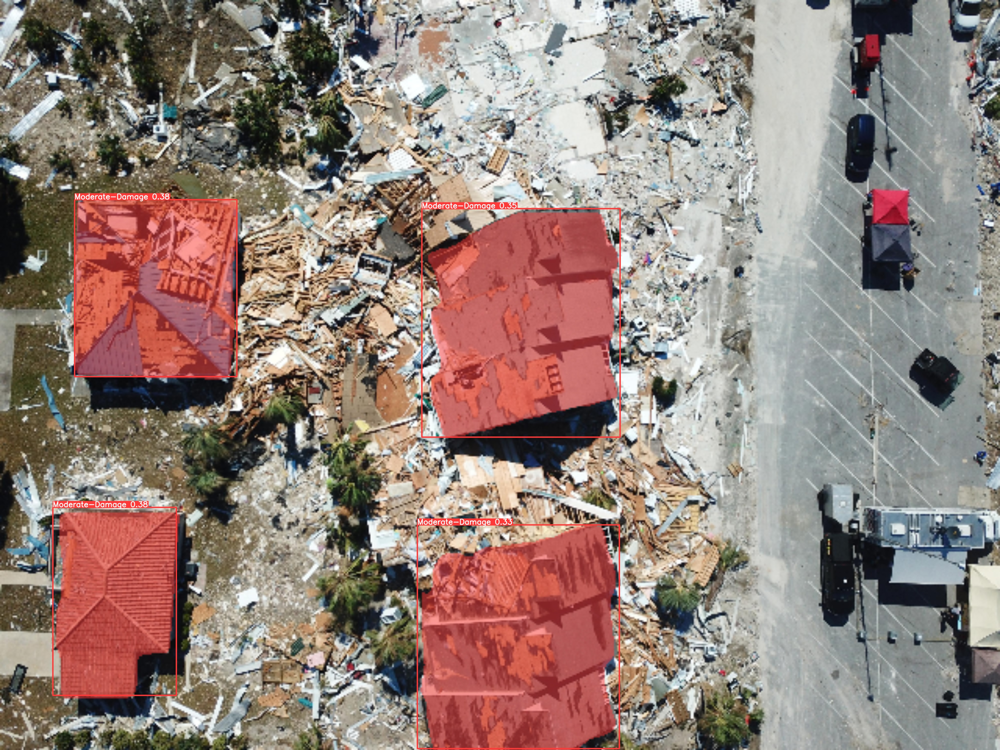

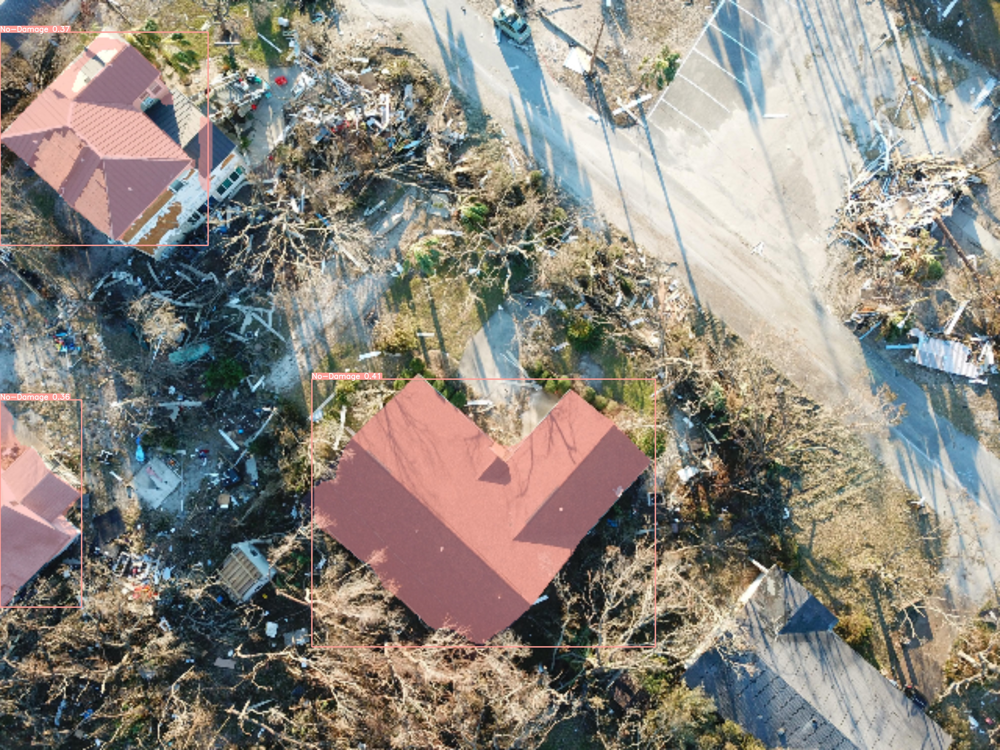

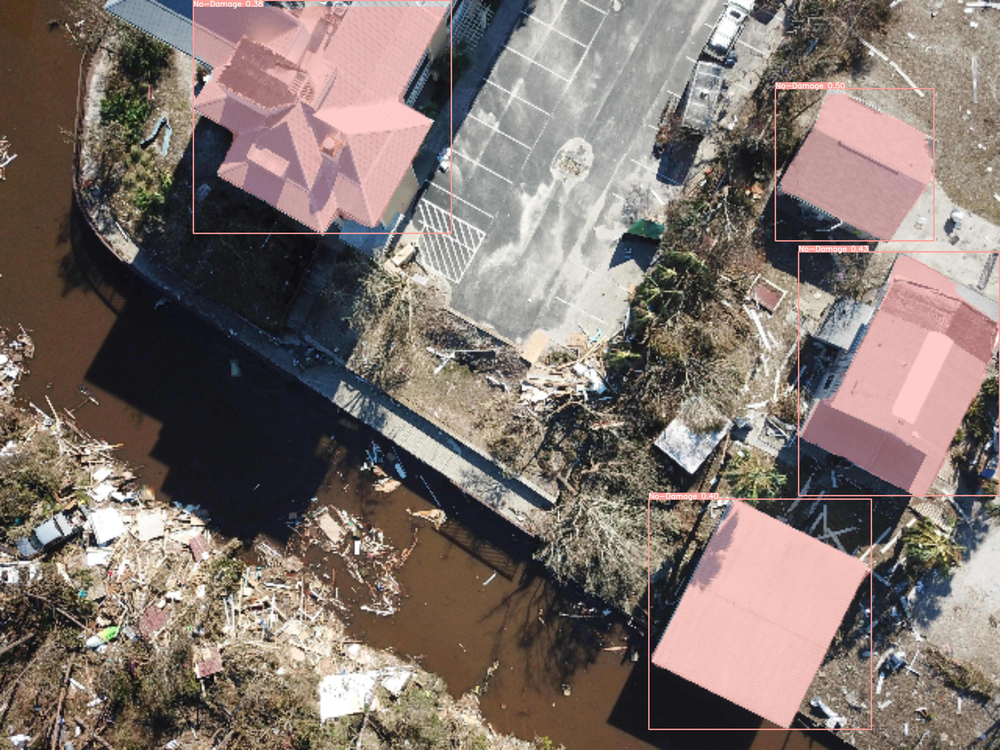

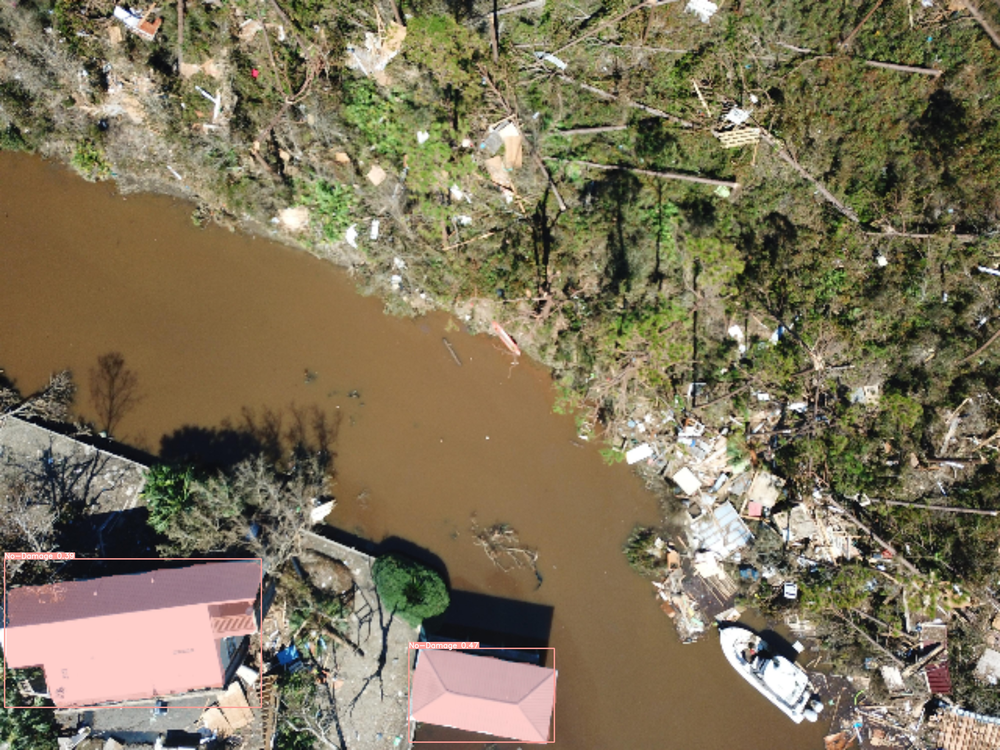

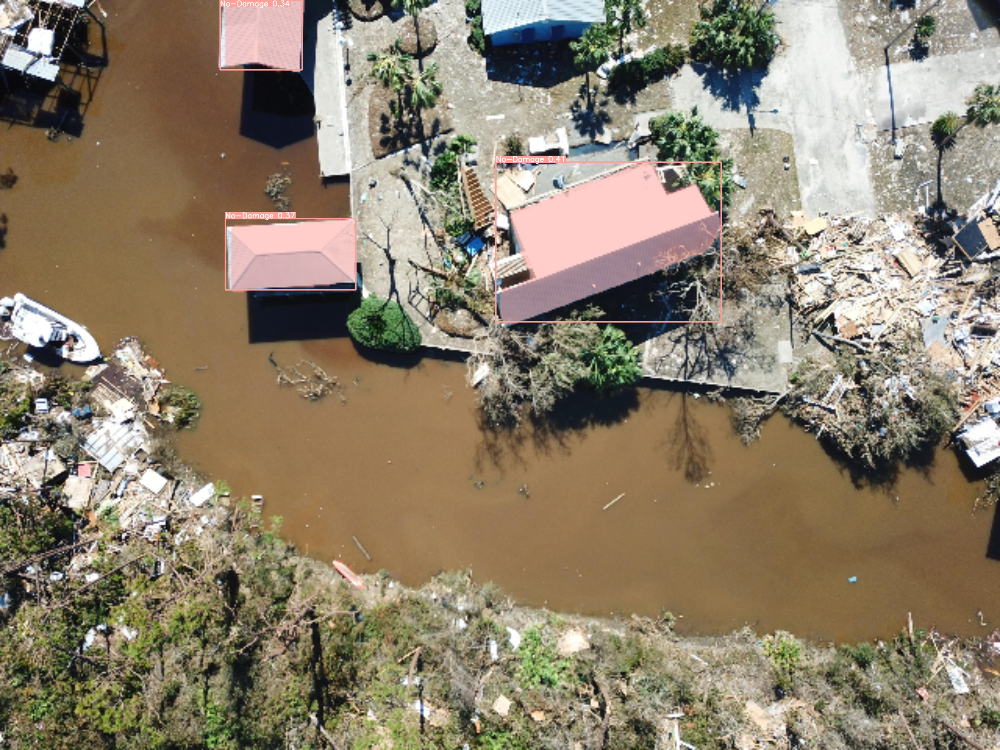

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/segment/predict2/*.jpg')[:5]:
      display(Image(filename=image_path, height=600))
      print("\n")

In [ ]:
%cd {HOME}

!yolo task=segment mode=train model=yolov8x-seg.pt data=/content/data.yaml epochs=10 imgsz=640

/content
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=segment, mode=train, model=yolov8x-seg.pt, data=/content/data.yaml, epochs=10, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=None, 